In [3]:
import os

base_path = "/kaggle/input/fashion-product-images-dataset/fashion-dataset"
print(os.listdir(base_path))


['images.csv', 'images', 'styles.csv', 'styles', 'fashion-dataset']


In [4]:
import pandas as pd

meta = pd.read_csv(os.path.join(base_path, "styles.csv"), on_bad_lines='skip')
print(meta)


          id gender masterCategory subCategory            articleType  \
0      15970    Men        Apparel     Topwear                 Shirts   
1      39386    Men        Apparel  Bottomwear                  Jeans   
2      59263  Women    Accessories     Watches                Watches   
3      21379    Men        Apparel  Bottomwear            Track Pants   
4      53759    Men        Apparel     Topwear                Tshirts   
...      ...    ...            ...         ...                    ...   
44419  17036    Men       Footwear       Shoes           Casual Shoes   
44420   6461    Men       Footwear  Flip Flops             Flip Flops   
44421  18842    Men        Apparel     Topwear                Tshirts   
44422  46694  Women  Personal Care   Fragrance  Perfume and Body Mist   
44423  51623  Women    Accessories     Watches                Watches   

      baseColour  season    year   usage  \
0      Navy Blue    Fall  2011.0  Casual   
1           Blue  Summer  2012.0  C

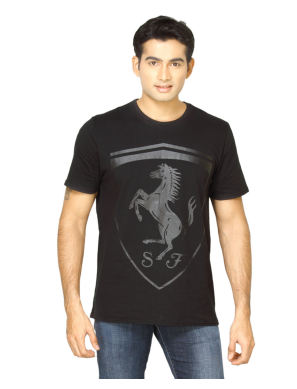

In [5]:
import cv2
import matplotlib.pyplot as plt

img_path = os.path.join(base_path, "images", "11255.jpg")  # Example ID
img = cv2.imread(img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

plt.imshow(img)
plt.axis("off")
plt.show()


In [6]:
# View all unique master categories
unique_categories = meta['masterCategory'].unique()
unique_articles= meta['articleType'].unique()
unique_subCategory = meta['subCategory'].unique()
print("Unique values in masterCategory:\n", unique_categories)

print("Unique values in unique_articles:\n\n", unique_articles)

print("Unique values in unique_subCategory:\n\n", unique_subCategory)

print("\nTotal unique categories:", len(unique_categories))
category_counts = meta['masterCategory'].value_counts()
print(category_counts)


Unique values in masterCategory:
 ['Apparel' 'Accessories' 'Footwear' 'Personal Care' 'Free Items'
 'Sporting Goods' 'Home']
Unique values in unique_articles:

 ['Shirts' 'Jeans' 'Watches' 'Track Pants' 'Tshirts' 'Socks' 'Casual Shoes'
 'Belts' 'Flip Flops' 'Handbags' 'Tops' 'Bra' 'Sandals' 'Shoe Accessories'
 'Sweatshirts' 'Deodorant' 'Formal Shoes' 'Bracelet' 'Lipstick' 'Flats'
 'Kurtas' 'Waistcoat' 'Sports Shoes' 'Shorts' 'Briefs' 'Sarees'
 'Perfume and Body Mist' 'Heels' 'Sunglasses' 'Innerwear Vests' 'Pendant'
 'Nail Polish' 'Laptop Bag' 'Scarves' 'Rain Jacket' 'Dresses'
 'Night suits' 'Skirts' 'Wallets' 'Blazers' 'Ring' 'Kurta Sets' 'Clutches'
 'Shrug' 'Backpacks' 'Caps' 'Trousers' 'Earrings' 'Camisoles' 'Boxers'
 'Jewellery Set' 'Dupatta' 'Capris' 'Lip Gloss' 'Bath Robe' 'Mufflers'
 'Tunics' 'Jackets' 'Trunk' 'Lounge Pants' 'Face Wash and Cleanser'
 'Necklace and Chains' 'Duffel Bag' 'Sports Sandals'
 'Foundation and Primer' 'Sweaters' 'Free Gifts' 'Trolley Bag'
 'Tracksuits' 'S

In [7]:
# Keep only rows where masterCategory == 'Apparel'
# apparel_df = meta[meta['masterCategory'] == 'Apparel']
# apparel_df = meta[meta['masterCategory'] == 'Apparel' || meta['subCategory'] == 'Topwear' || meta['subCategory'] == 'Bottomwear' || meta['subCategory'] == 'Saree' || meta['subCategory'] == 'Dress' || meta['subCategory'] == 'Loungewear' || meta['subCategory'] == 'Nightwear' || meta['subCategory'] == 'Apparel Set' || meta['subCategory'] == 'Mufflers' || meta['subCategory'] == 'Gloves']
apparel_df = meta[
    (meta['masterCategory'] == 'Apparel') &
    (meta['subCategory'].isin(['Topwear', 'Bottomwear', 'Saree', 'Dress',
                               'Loungewear', 'Nightwear', 'Apparel Set',
                               'Mufflers', 'Gloves']))
]

# Drop any rows missing an ID or image
apparel_df = apparel_df.dropna(subset=['id'])

print("Total Apparel items:", len(apparel_df))
apparel_df.head()


Total Apparel items: 19107


,id,gender,masterCategory,subCategory,articleType,baseColour,season,year,usage,productDisplayName
0,15970,Men,Apparel,Topwear,Shirts,Navy Blue,Fall,2011.0,Casual,Turtle Check Men Navy Blue Shirt
1,39386,Men,Apparel,Bottomwear,Jeans,Blue,Summer,2012.0,Casual,Peter England Men Party Blue Jeans
3,21379,Men,Apparel,Bottomwear,Track Pants,Black,Fall,2011.0,Casual,Manchester United Men Solid Black Track Pants
4,53759,Men,Apparel,Topwear,Tshirts,Grey,Summer,2012.0,Casual,Puma Men Grey T-shirt
5,1855,Men,Apparel,Topwear,Tshirts,Grey,Summer,2011.0,Casual,Inkfruit Mens Chain Reaction T-shirt


In [8]:
import shutil
import random

# Create target folders
inventory_dir = "/kaggle/working/inventory"
query_dir = "/kaggle/working/query"
os.makedirs(inventory_dir, exist_ok=True)
os.makedirs(query_dir, exist_ok=True)

image_dir = os.path.join(base_path, "images")
all_images = os.listdir(image_dir)
# Shuffle and pick sample
apparel_ids = apparel_df['id'].astype(str).tolist()
random.shuffle(apparel_ids)

selected_ids = apparel_ids[:2000]  # take first 2000 apparel items
query_ids = random.sample(selected_ids, 100)  # pick 100 queries

# Copy files safely
for img_id in selected_ids:
    src = os.path.join(image_dir, img_id + ".jpg")
    dst = os.path.join(inventory_dir, img_id + ".jpg")
    if os.path.exists(src):
        shutil.copy(src, dst)

for img_id in query_ids:
    src = os.path.join(image_dir, img_id + ".jpg")
    dst = os.path.join(query_dir, img_id + ".jpg")
    if os.path.exists(src):
        shutil.copy(src, dst)

print(" Apparel images copied successfully.")

# import shutil
# import random

# inventory_dir = "/kaggle/working/inventory"
# query_dir = "/kaggle/working/query"
# os.makedirs(inventory_dir, exist_ok=True)
# os.makedirs(query_dir, exist_ok=True)

# image_dir = os.path.join(base_path, "images")
# all_images = os.listdir(image_dir)

# # Randomly sample
# random.shuffle(all_images)
# inventory_images = all_images[:2000]
# query_images = random.sample(inventory_images, 100)

# for img_name in inventory_images:
#     shutil.copy(os.path.join(image_dir, img_name), inventory_dir)

# for img_name in query_images:
#     shutil.copy(os.path.join(image_dir, img_name), query_dir)


KeyboardInterrupt: 

In [18]:
# !rm -rf /kaggle/working/inventory/10007.jpg
# !rm -f /kaggle/working/inventory/10007.jpg


In [19]:
import cv2
import random
def preprocess_image(img_path):
    img = cv2.imread(img_path)
    if img is None:
        return None
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    resized = cv2.resize(gray, (400, 400))
    return resized


# Example
# sample_img = random.choice(os.listdir(inventory_dir))
# img = preprocess_image(os.path.join(inventory_dir, sample_img))
# plt.imshow(img, cmap='gray')
# plt.axis('off')
# plt.show()


In [ ]:
def extract_features(img):
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(img, None)
    return keypoints, descriptors


In [ ]:
def match_features(desc1, desc2):
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    matches = flann.knnMatch(desc1, desc2, k=2)

    # Lowe’s ratio test to keep good matches
    good_matches = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)
    return good_matches


In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt

def find_best_match(query_path, inventory_dir, top_k=3):
    query_img = preprocess_image(query_path)
    if query_img is None:
        print("Query image not found or unreadable.")
        return []
    
    _, query_desc = extract_features(query_img)
    results = []

    for filename in os.listdir(inventory_dir):
        inv_path = os.path.join(inventory_dir, filename)
        inv_img = preprocess_image(inv_path)
        if inv_img is None:
            continue
        
        _, inv_desc = extract_features(inv_img)
        if inv_desc is None or len(inv_desc) == 0:
            continue
        
        good_matches = match_features(query_desc, inv_desc)
        score = len(good_matches)  # more matches = more similar
        results.append((filename, score))

    # Sort by descending match score
    results.sort(key=lambda x: x[1], reverse=True)
    return results[:top_k]


In [9]:
def visualize_matches(query_path, inventory_dir, best_matches):
    query_img = preprocess_image(query_path)
    kp1, desc1 = extract_features(query_img)

    plt.figure(figsize=(15,5))
    for i, (fname, score) in enumerate(best_matches):
        inv_img = preprocess_image(os.path.join(inventory_dir, fname))
        kp2, desc2 = extract_features(inv_img)
        good_matches = match_features(desc1, desc2)

        match_img = cv2.drawMatches(query_img, kp1, inv_img, kp2, good_matches[:10], None, flags=2)
        plt.subplot(1, len(best_matches), i+1)
        plt.imshow(match_img, cmap='gray')
        plt.title(f"{fname}\nScore: {score}")
        plt.axis('off')
    plt.show()


In [ ]:
query_path = "/kaggle/working/query/10438.jpg"  # example query
inventory_dir = "/kaggle/working/inventory"

best_matches = find_best_match(query_path, inventory_dir, top_k=3)
print("Top Matches:", best_matches)

visualize_matches(query_path, inventory_dir, best_matches)


In [ ]:
# Ask user to enter the path of the query image
query_image_path = input("Enter the full path of the image to search: ")

# Run your existing visual search
best_matches = find_best_match(query_image_path, inventory_dir, top_k=3)
visualize_matches(query_image_path, inventory_dir, best_matches)


In [ ]:
def process_image(b):
    print("s")
    if len(upload.value) == 0:
        with output:
            clear_output()
            print("No file uploaded yet!")
        return
    
    # Get uploaded file
    uploaded_file = list(upload.value.values())[0]
    content = uploaded_file['content']
    filename = uploaded_file['metadata']['name']
    
    # Save file
    filepath = os.path.join(UPLOAD_DIR, filename)
    with open(filepath, 'wb') as f:
        f.write(content)
    
    # Display uploaded image
    with output:
        clear_output()
        print(f"File saved to: {filepath}")
        img = Image.open(filepath)
        display(img)
    
    # Call your visual search functions
    best_matches = find_best_match(filepath, "inventory_folder", top_k=3)
    
    visualize_matches(filepath, "inventory_folder", best_matches)

In [1]:
print("sd")

sd


# Version 2


In [16]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("agrigorev/clothing-dataset-full")

print("Path to dataset files:", path)

Path to dataset files: /kaggle/input/clothing-dataset-full


In [10]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import torch
import torch.nn as nn
from torchvision import models, transforms
from sklearn.metrics.pairwise import cosine_similarity
import pickle
from tqdm import tqdm

# ==================== SETUP ====================
base_path = "/kaggle/input/fashion-product-images-dataset/fashion-dataset"
inventory_dir = "/kaggle/working/inventory"
query_dir = "/kaggle/working/query"

# ==================== FEATURE EXTRACTOR ====================
class FeatureExtractor:
    """Extract deep learning features using pretrained ResNet50"""
    
    def __init__(self, model_name='resnet50'):
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        print(f"Using device: {self.device}")
        
        # Load pretrained model
        if model_name == 'resnet50':
            self.model = models.resnet50(pretrained=True)
            # Remove final classification layer to get features
            self.model = nn.Sequential(*list(self.model.children())[:-1])
        
        self.model = self.model.to(self.device)
        self.model.eval()
        
        # Image preprocessing pipeline
        self.transform = transforms.Compose([
            transforms.Resize((224, 224)),
            transforms.ToTensor(),
            transforms.Normalize(
                mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]
            )
        ])
    
    def extract_features(self, img_path):
        """Extract feature vector from image"""
        try:
            # Load and preprocess image
            img = Image.open(img_path).convert('RGB')
            img_tensor = self.transform(img).unsqueeze(0).to(self.device)
            
            # Extract features
            with torch.no_grad():
                features = self.model(img_tensor)
            
            # Flatten and normalize
            features = features.squeeze().cpu().numpy()
            features = features / np.linalg.norm(features)  # L2 normalization
            
            return features
        except Exception as e:
            print(f"Error processing {img_path}: {e}")
            return None
    
    def extract_color_histogram(self, img_path, bins=32):
        """Extract color histogram features"""
        try:
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, (224, 224))
            
            # Calculate histogram for each channel
            hist_features = []
            for i in range(3):
                hist = cv2.calcHist([img], [i], None, [bins], [0, 256])
                hist = hist.flatten()
                hist_features.extend(hist)
            
            hist_features = np.array(hist_features)
            hist_features = hist_features / np.linalg.norm(hist_features)
            
            return hist_features
        except Exception as e:
            print(f"Error extracting color from {img_path}: {e}")
            return None

# ==================== INDEX BUILDER ====================
class FashionSearchIndex:
    """Build and search index of fashion products"""
    
    def __init__(self, feature_extractor):
        self.extractor = feature_extractor
        self.features_db = {}
        self.color_db = {}
        self.image_paths = []
    
    def build_index(self, inventory_dir, save_path='fashion_index.pkl'):
        """Build index from inventory images"""
        print("Building search index...")
        
        image_files = [f for f in os.listdir(inventory_dir) if f.endswith('.jpg')]
        
        for img_file in tqdm(image_files, desc="Extracting features"):
            img_path = os.path.join(inventory_dir, img_file)
            
            # Extract deep features
            features = self.extractor.extract_features(img_path)
            if features is not None:
                self.features_db[img_file] = features
            
            # Extract color features
            color_features = self.extractor.extract_color_histogram(img_path)
            if color_features is not None:
                self.color_db[img_file] = color_features
            
            self.image_paths.append(img_path)
        
        print(f"Indexed {len(self.features_db)} images")
        
        # Save index
        self.save_index(save_path)
    
    def save_index(self, save_path):
        """Save index to disk"""
        index_data = {
            'features_db': self.features_db,
            'color_db': self.color_db,
            'image_paths': self.image_paths
        }
        with open(save_path, 'wb') as f:
            pickle.dump(index_data, f)
        print(f"Index saved to {save_path}")
    
    def load_index(self, load_path):
        """Load index from disk"""
        with open(load_path, 'rb') as f:
            index_data = pickle.load(f)
        
        self.features_db = index_data['features_db']
        self.color_db = index_data['color_db']
        self.image_paths = index_data['image_paths']
        print(f"Index loaded from {load_path}")
    
    def search(self, query_path, top_k=5, color_weight=0.3):
        """
        Search for similar images
        
        Args:
            query_path: Path to query image
            top_k: Number of results to return
            color_weight: Weight for color similarity (0-1), rest is semantic
        """
        # Extract query features
        query_features = self.extractor.extract_features(query_path)
        query_color = self.extractor.extract_color_histogram(query_path)
        
        if query_features is None:
            print("Could not extract features from query image")
            return []
        
        # Calculate similarities
        results = []
        for img_file, inv_features in self.features_db.items():
            # Semantic similarity (cosine similarity)
            semantic_sim = np.dot(query_features, inv_features)
            
            # Color similarity
            color_sim = 0
            if query_color is not None and img_file in self.color_db:
                color_sim = np.dot(query_color, self.color_db[img_file])
            
            # Combined score
            combined_score = (1 - color_weight) * semantic_sim + color_weight * color_sim
            
            results.append((img_file, combined_score, semantic_sim, color_sim))
        
        # Sort by combined score
        results.sort(key=lambda x: x[1], reverse=True)
        
        return results[:top_k]

# ==================== VISUALIZATION ====================
def visualize_results(query_path, results, inventory_dir):
    """Visualize query and top matches"""
    n_results = len(results)
    fig, axes = plt.subplots(1, n_results + 1, figsize=(4 * (n_results + 1), 5))
    
    # Show query image
    query_img = Image.open(query_path)
    axes[0].imshow(query_img)
    axes[0].set_title("Query Image", fontsize=12, fontweight='bold')
    axes[0].axis('off')
    
    # Show results
    for i, (img_file, combined_score, semantic_sim, color_sim) in enumerate(results):
        img_path = os.path.join(inventory_dir, img_file)
        img = Image.open(img_path)
        axes[i + 1].imshow(img)
        axes[i + 1].set_title(
            f"Rank {i+1}\n"
            f"Score: {combined_score:.3f}\n"
            f"Semantic: {semantic_sim:.3f}\n"
            f"Color: {color_sim:.3f}",
            fontsize=10
        )
        axes[i + 1].axis('off')
    
    plt.tight_layout()
    plt.show()

def compare_with_metadata(results, query_id, meta_df, inventory_dir):
    """Compare results with actual metadata"""
    print("\n" + "="*80)
    print("METADATA COMPARISON")
    print("="*80)
    
    # Get query metadata
    query_id_int = int(query_id.replace('.jpg', ''))
    if query_id_int in meta_df['id'].values:
        query_meta = meta_df[meta_df['id'] == query_id_int].iloc[0]
        print(f"\nQUERY IMAGE ({query_id}):")
        print(f"  Category: {query_meta.get('masterCategory', 'N/A')}")
        print(f"  Subcategory: {query_meta.get('subCategory', 'N/A')}")
        print(f"  Article Type: {query_meta.get('articleType', 'N/A')}")
        print(f"  Color: {query_meta.get('baseColour', 'N/A')}")
    
    print(f"\nTOP {len(results)} MATCHES:")
    for i, (img_file, score, sem_sim, col_sim) in enumerate(results):
        match_id = int(img_file.replace('.jpg', ''))
        if match_id in meta_df['id'].values:
            match_meta = meta_df[meta_df['id'] == match_id].iloc[0]
            print(f"\n{i+1}. {img_file} (Score: {score:.3f})")
            print(f"   Category: {match_meta.get('masterCategory', 'N/A')}")
            print(f"   Subcategory: {match_meta.get('subCategory', 'N/A')}")
            print(f"   Article Type: {match_meta.get('articleType', 'N/A')}")
            print(f"   Color: {match_meta.get('baseColour', 'N/A')}")

# ==================== MAIN EXECUTION ====================
if __name__ == "__main__":
    # Initialize feature extractor
    print("Initializing feature extractor...")
    extractor = FeatureExtractor(model_name='resnet50')
    
    # Create search index
    search_index = FashionSearchIndex(extractor)
    
    # Build or load index
    index_path = 'fashion_index.pkl'
    if os.path.exists(index_path):
        print(f"Loading existing index from {index_path}...")
        search_index.load_index(index_path)
    else:
        print("Building new index...")
        search_index.build_index(inventory_dir, save_path=index_path)
    
    # Load metadata for comparison
    meta = pd.read_csv(os.path.join(base_path, "styles.csv"), on_bad_lines='skip')
    
    # Run search on a query image
    query_files = os.listdir(query_dir)
    if query_files:
        query_file = query_files[0]  # Use first query image
        query_path = os.path.join(query_dir, query_file)
        
        print(f"\nSearching for similar items to: {query_file}")
        results = search_index.search(query_path, top_k=5, color_weight=0.3)
        
        # Visualize results
        visualize_results(query_path, results, inventory_dir)
        
        # Compare with metadata
        compare_with_metadata(results, query_file, meta, inventory_dir)
    
    print("\n" + "="*80)
    print("Search system ready! Use search_index.search(query_path) to find matches")
    print("="*80)

Initializing feature extractor...
Using device: cuda


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Building new index...
Building search index...


Extracting features:  39%|███▊      | 555/1433 [00:36<00:56, 15.53it/s]

Error processing /kaggle/working/inventory/3732.jpg: cannot identify image file '/kaggle/working/inventory/3732.jpg'
Error extracting color from /kaggle/working/inventory/3732.jpg: OpenCV(4.12.0) /io/opencv/modules/imgproc/src/color.cpp:199: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'



Extracting features: 100%|██████████| 1433/1433 [01:32<00:00, 15.46it/s]

Indexed 1432 images
Index saved to fashion_index.pkl

Search system ready! Use search_index.search(query_path) to find matches


In [11]:
search_index.search("/kaggle/input/test111/hello.jpg")

[('26315.jpg', 0.8178341209888458, 0.8150922, 0.8242319),
 ('7791.jpg', 0.8108027875423431, 0.848077, 0.7238296),
 ('11348.jpg', 0.7269931793212889, 0.8419653, 0.45872486),
 ('23872.jpg', 0.7152131795883179, 0.89896864, 0.28645045),
 ('3054.jpg', 0.7118980407714843, 0.87025666, 0.3423946)]

In [14]:
import matplotlib.pyplot as plt
from PIL import Image
import os

def show_search_results(query_path, results, inventory_dir):
    if not results:
        print("No results found.")
        return
    
    n = len(results)

    # Prepare plot
    fig, axes = plt.subplots(1, n + 1, figsize=(4 * (n + 1), 5))

    # --- Show query image ---
    query_img = Image.open(query_path)
    axes[0].imshow(query_img)
    axes[0].set_title("Query Image")
    axes[0].axis("off")

    # --- Show matched images ---
    for i, (img_file, combined, semantic, color) in enumerate(results):
        img_path = os.path.join(inventory_dir, img_file)
        img = Image.open(img_path)

        axes[i + 1].imshow(img)
        axes[i + 1].set_title(
            f"Match {i+1}\nScore: {combined:.3f}\nSem: {semantic:.3f}\nColor: {color:.3f}"
        )
        axes[i + 1].axis("off")

    plt.tight_layout()
    plt.show()



===== QUERY 1: d619091d-fc8d-4730-9f3c-2a042e876272.jpg =====


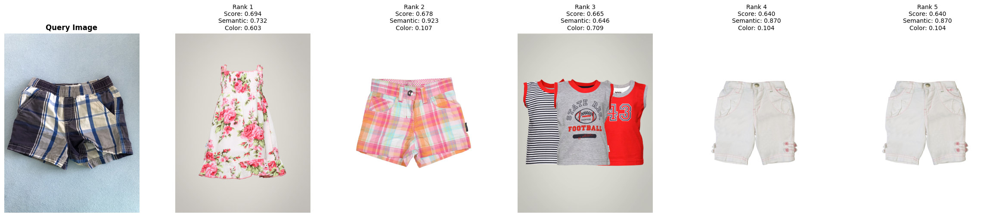


===== QUERY 2: b0d71fba-23a7-4912-b6c6-16b7d8a5bd43.jpg =====


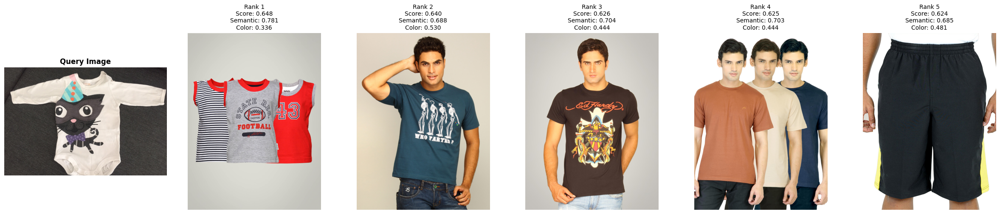


===== QUERY 3: 7f17b410-d375-409e-b5b3-010122df5748.jpg =====


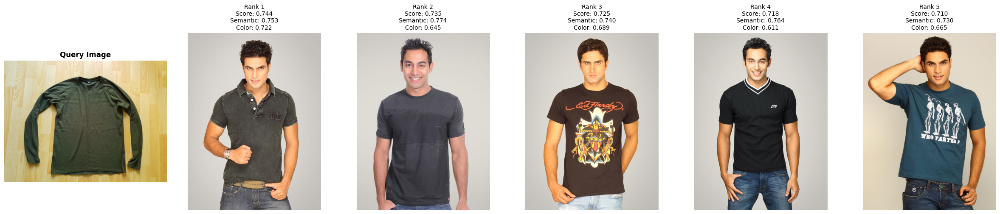


===== QUERY 4: a1935717-7c7e-448c-9359-9c958ebbd2eb.jpg =====


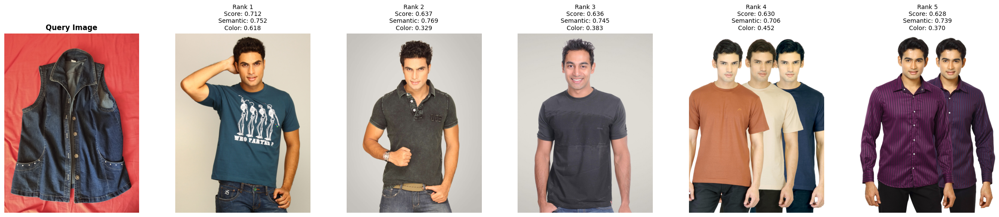


===== QUERY 5: 638f066a-218c-4850-9771-4883a908d6a3.jpg =====


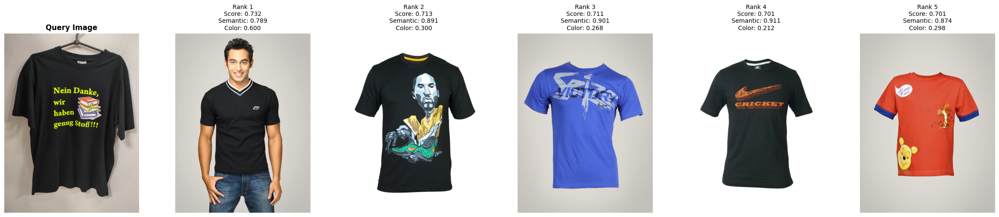


===== QUERY 6: 0c024616-1289-4747-91da-71a4aedd4ced.jpg =====


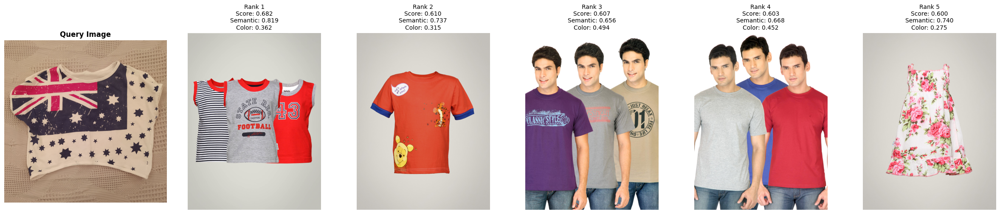


===== QUERY 7: bf583ce5-a849-44b8-afe9-59ab221d9d27.jpg =====


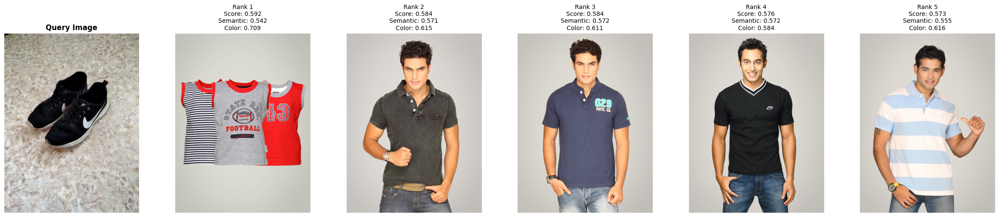


===== QUERY 8: ebb27e08-5ec0-4107-b857-170dd8861cb8.jpg =====


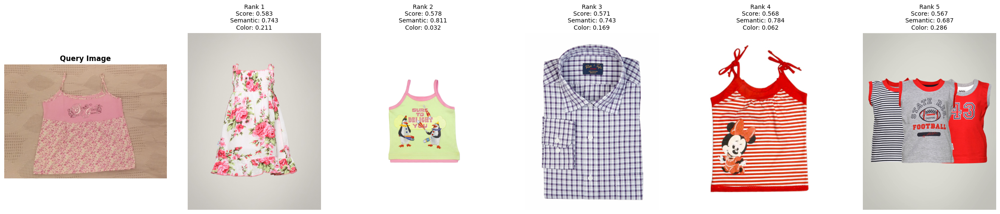


===== QUERY 9: 51bdf9e1-6ff4-46fe-9051-2821fff88f85.jpg =====


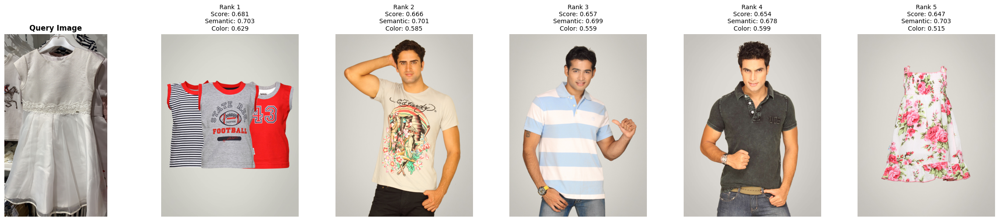


===== QUERY 10: 186eb9e1-79fa-4aba-97c8-f2da0e6a2413.jpg =====


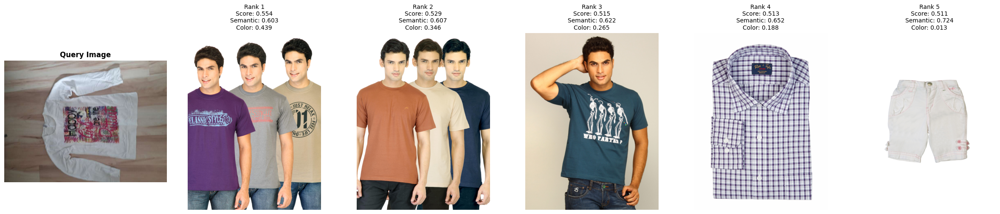


===== QUERY 11: 6a88ed88-4090-4874-92d7-fdc534b6df9f.jpg =====


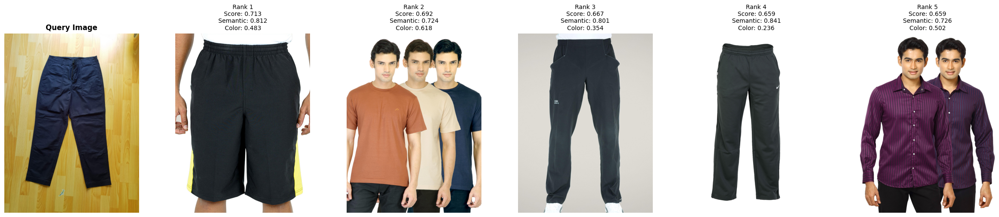


===== QUERY 12: a7a8fafc-8f77-4117-807a-f4a2f09741aa.jpg =====


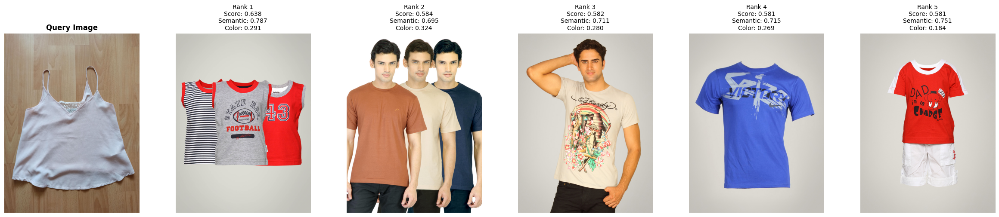


===== QUERY 13: c763b1d1-ed61-4545-b740-501363ca613f.jpg =====


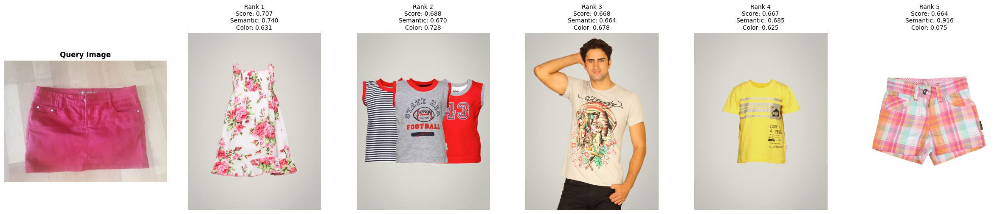


===== QUERY 14: a5e4efe1-e068-4e88-abcc-ce7779c004ea.jpg =====


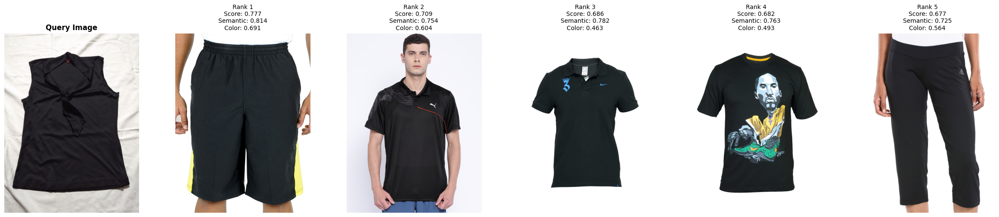


===== QUERY 15: 42518e91-c969-49f5-ac68-dfe394d7451e.jpg =====


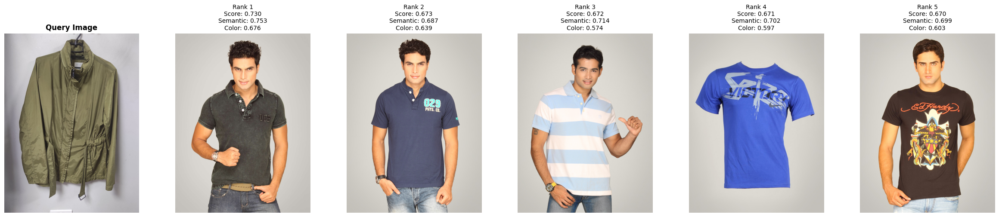


===== QUERY 16: 831e024c-83b5-4f66-b9ad-4cd85e6454d4.jpg =====


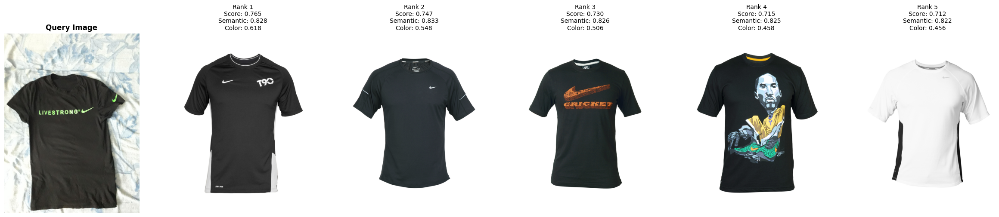


===== QUERY 17: d6a35b67-5647-4626-8c36-6b63ba5f6c12.jpg =====


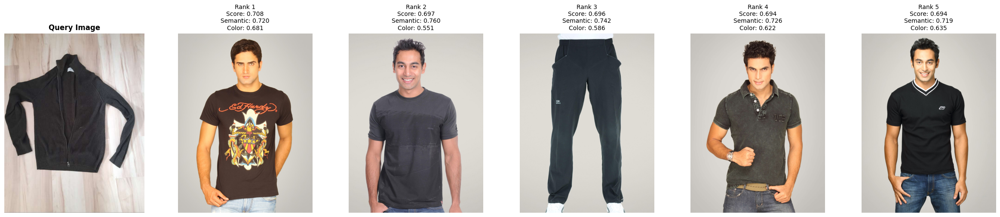


===== QUERY 18: 1ae0fc32-65dc-4373-9550-6b74732bf72e.jpg =====


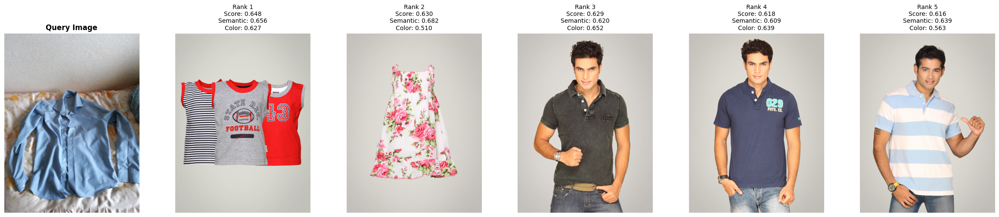


===== QUERY 19: 66085e89-f395-4a3d-b6bc-b254154b7418.jpg =====


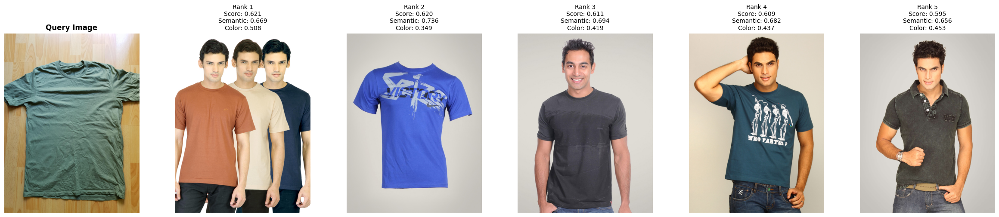


===== QUERY 20: ef8d972e-d971-48d4-85b0-ca34297e6f3e.jpg =====


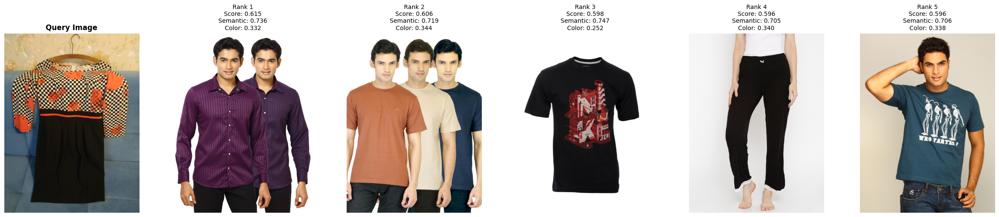

In [21]:
query_folder = "/kaggle/input/clothing-dataset-full/images_original"
query_files = [f for f in os.listdir(query_folder) if f.lower().endswith(('.jpg', '.png', '.jpeg'))]

# Take first 10 images (or fewer if the folder has less)
query_files = query_files[:20]

for i, qf in enumerate(query_files):
    print(f"\n===== QUERY {i+1}: {qf} =====")
    
    query_path = os.path.join(query_folder, qf)

    # Run search
    results = search_index.search(query_path, top_k=5, color_weight=0.3)

    # Visualize results
    visualize_results(query_path, results, inventory_dir)
